<a href="https://colab.research.google.com/github/orhbulu/Machine-Learning/blob/master/Mask_RCNN_Finding_Wally.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mask R-CNN - Finding Wally

Making use of Matterport's Mask R-CNN implementation for object detecion and image segmentisation for Finding Wally

## References
Data obtained from : https://github.com/vc1492a/Hey-Waldo & https://github.com/alseambusher/deepwaldo

Matterport Mask-RCNN : https://github.com/matterport/Mask_RCNN

Pre-trained COCO weights (mask_rcnn_coco.h5) : https://github.com/matterport/Mask_RCNN/releases/download/v2.0/mask_rcnn_coco.h5




In [0]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [0]:
!nvidia-smi

Sat Apr 25 01:54:10 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

## Downloading Dataset and Mask-RCNN model

In [0]:
!git clone https://github.com/orhbulu/Mask_RCNN.git
# cloning a copy of matterport Mask_RCNN with minor edit to model.py and placing dataset into Mask_RCNN directory

Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 1033 (delta 0), reused 3 (delta 0), pack-reused 1026
Receiving objects: 100% (1033/1033), 182.83 MiB | 13.15 MiB/s, done.
Resolving deltas: 100% (583/583), done.


In [0]:
from google.colab import drive
drive.mount('/content/drive')
# Mount drive to retreive COCO weights

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
cd Mask_RCNN

/content/Mask_RCNN


## We need to copy the dataset to Mask_RCNN/datasets/ballon

### Now get back to the samples folder to make sure our code runs properly from there

In [0]:

import os
import sys
import random
import math
import re
import time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
import skimage.draw
import json
from PIL import Image
%matplotlib inline 

# Root directory of the project
ROOT_DIR = os.path.abspath("../../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

## Configurations

Mask-RCNN Configurations

## Dataset

In [0]:
class Trainingconfig(Config):
    NAME = "wally"
    IMAGES_PER_GPU = 2
    NUM_CLASSES = 2 # Wally + Background
    STEPS_PER_EPOCH = 100
    DETECTION_MIN_CONFIDENCE = 0.9  # Minimum probability value to accept a detected instance

In [0]:
class Inferenceconfig(Config):
    NAME = "wally"
    IMAGES_PER_GPU = 1
    NUM_CLASSES = 2 # Wally + Background
    STEPS_PER_EPOCH = 100
    DETECTION_MIN_CONFIDENCE = 0.9  # Minimum probability value to accept a detected instance

Create a class for the dataset

In [0]:
DATA_DIR = "/content/Mask_RCNN/data"
MODEL_DIR ='/content/Mask_RCNN/data/logs'
COCO_WEIGHTS_PATH = '/content/drive/My Drive/Colab Notebooks/COCO/mask_rcnn_coco.h5'

In [0]:
class WallyDataset(utils.Dataset):
  """Load a subset of the Wally dataset.
  dataset_dir: Root directory of the dataset.
  subset: Subset to load: (64x64 / 128x128 / 256x256) AND (Colour / BlackWhite / Greyscale)
  """
  # Modified version of coco data loader and balloon data loader from Mask-RCNN
  # Add classes. We have only one class to add.


  def load(self, dataset_dir, subset):
    self.add_class("wally", 1, "wally")
    dataset_dir = os.path.join(dataset_dir, subset)
    annotations = list(json.load(open(os.path.join(dataset_dir, "via_region_data.json"))).values())
    # skip unannotated images.
    annotations = [a for a in annotations if a['regions']]

    # Add images
    for a in annotations:
      polygons = [r['shape_attributes'] for r in a['regions'].values()]

      image_path = os.path.join(dataset_dir, a['filename'])
      image = skimage.io.imread(image_path)
      height, width = image.shape[:2]

      self.add_image(
        "wally",
        image_id=a['filename'],
        path=image_path,
        width=width, height=height,
        polygons=polygons)

  def load_mask(self, image_id):
    image_info = self.image_info[image_id]
    if image_info["source"] != "wally":
      return super(self.__class__, self).load_mask(image_id)

    info = self.image_info[image_id]
    mask = np.zeros([info["height"], info["width"], len(info["polygons"])],
                        dtype=np.uint8)
    for i, p in enumerate(info["polygons"]):
      rr, cc = skimage.draw.polygon(p['all_points_y'], p['all_points_x'])
      mask[rr, cc, i] = 1

    return mask.astype(np.bool), np.ones([mask.shape[-1]], dtype=np.int32)

  def image_reference(self, image_id):
    info = self.image_info[image_id]
    if info["source"] == "wally":
      return info["path"]
    else:
      super(self.__class__, self).image_reference(image_id)


## Training

In [0]:
config = Trainingconfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [0]:
dataset_train = WallyDataset()
dataset_train.load(DATA_DIR, "train")
dataset_train.prepare()

In [0]:
dataset_val = WallyDataset()
dataset_val.load(DATA_DIR, "val")
dataset_val.prepare()

In [0]:
model = modellib.MaskRCNN(mode="training", config=config,model_dir=MODEL_DIR)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
box_ind is deprecated, use box_indices instead


In [0]:
weights_path = COCO_WEIGHTS_PATH
# Download weights file
if not os.path.exists(weights_path):
  utils.download_trained_weights(weights_path)

# Excluding last layers
model.load_weights(weights_path, by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc", "mrcnn_bbox", "mrcnn_mask"])


In [0]:
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=40,
            layers='heads')


Starting at epoch 0. LR=0.001

Checkpoint Path: /content/Mask_RCNN/data/logs/wally20200425T0156/mask_rcnn_wally_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mask

/tensorflow-1.15.2/python3.6/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/tensorflow-1.15.2/python3.6/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/tensorflow-1.15.2/python3.6/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:49: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the `keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


Epoch 1/40
100/100 [==============================] - 118s 1s/step - loss: 1.7847 - rpn_class_loss: 0.1659 - rpn_bbox_loss: 0.7607 - mrcnn_class_loss: 0.0179 - mrcnn_bbox_loss: 0.5709 - mrcnn_mask_loss: 0.2693 - val_loss: 1.1686 - val_rpn_class_loss: 0.2158 - val_rpn_bbox_loss: 1.2200 - val_mrcnn_class_loss: 0.0062 - val_mrcnn_bbox_loss: 0.1525 - val_mrcnn_mask_loss: 0.1613

Epoch 2/40
100/100 [==============================] - 71s 705ms/step - loss: 1.6474 - rpn_class_loss: 0.1257 - rpn_bbox_loss: 0.6543 - mrcnn_class_loss: 0.0127 - mrcnn_bbox_loss: 0.5761 - mrcnn_mask_loss: 0.2786 - val_loss: 2.3220 - val_rpn_class_loss: 0.1960 - val_rpn_bbox_loss: 1.0478 - val_mrcnn_class_loss: 0.0064 - val_mrcnn_bbox_loss: 0.2817 - val_mrcnn_mask_loss: 0.2207
Epoch 3/40
100/100 [==============================] - 72s 719ms/step - loss: 1.2118 - rpn_class_loss: 0.0771 - rpn_bbox_loss: 0.4385 - mrcnn_class_loss: 0.0163 - mrcnn_bbox_loss: 0.3672 - mrcnn_mask_loss: 0.3127 - val_loss: 1.6620 - val_rpn_cl

## Results

Load and display results with colour. Taken from Mask-RCNN (Balloon example)

40 Epochs were ran and model was tested with various images. 

Epoch 37 was chosen to have the best results

In [18]:
config = Inferenceconfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [19]:
model = modellib.MaskRCNN(mode="inference", config=config, model_dir=MODEL_DIR)



Instructions for updating:
Use `tf.cast` instead.


# EPOCH 37

In [71]:
model.load_weights("/content/Mask_RCNN/data/logs/wally20200425T0156/mask_rcnn_wally_0037.h5", by_name=True)

Re-starting from epoch 37


In [88]:
TEST_IMG = "/content/Mask_RCNN/data/val/5.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (1760, 2100, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 2100.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


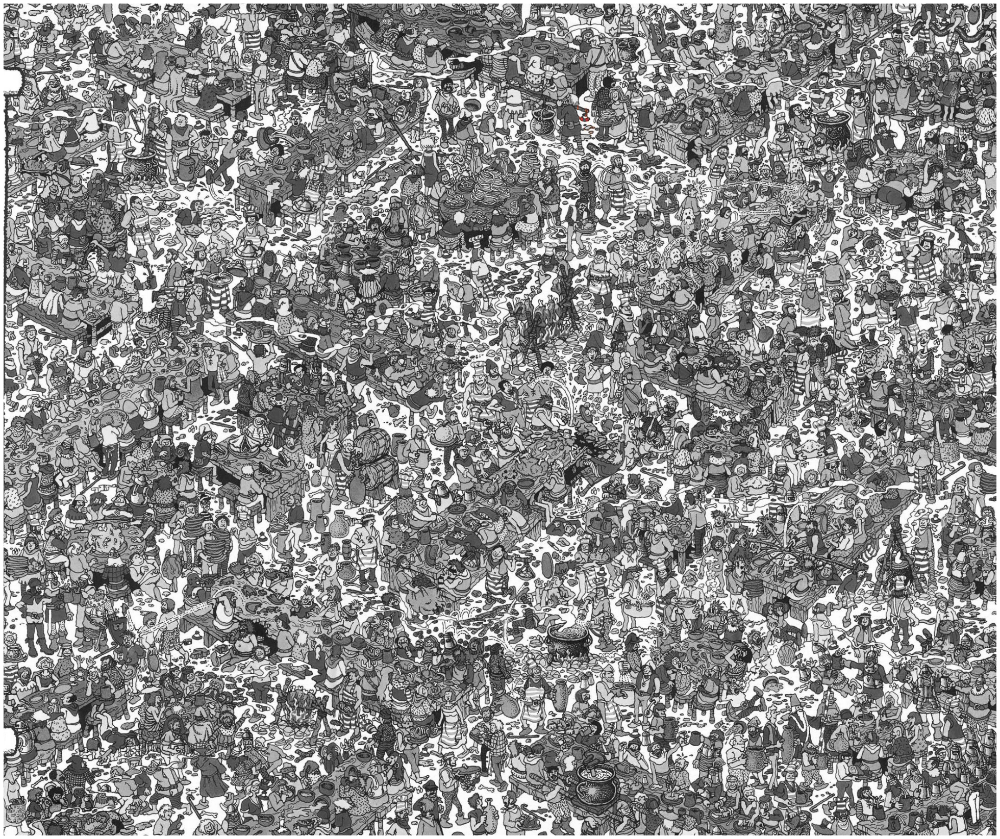

In [73]:
plt.figure(figsize=(45, 30))
plt.axis('off')
plt.imshow(img)
# Wally was not accurately predicted in this image. There are a few instances where wally could not be detected.

In [74]:
TEST_IMG = "/content/Mask_RCNN/data/val/11.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (1828, 2828, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 2828.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


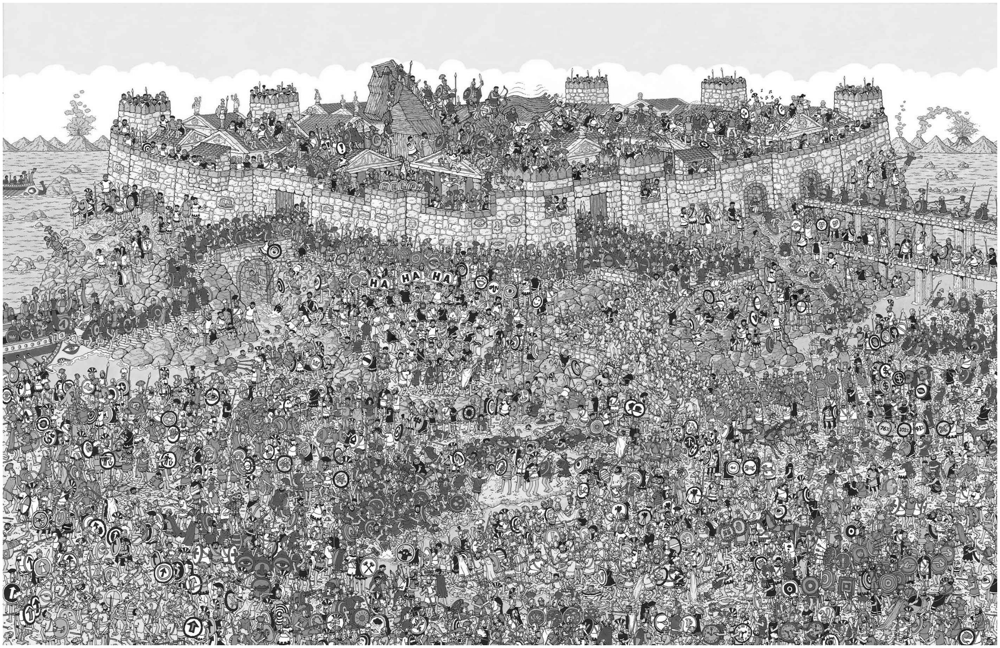

In [75]:
plt.figure(figsize=(45, 30))
plt.axis('off')
plt.imshow(img)

In [76]:
TEST_IMG = "/content/Mask_RCNN/data/train/40.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (256, 256, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


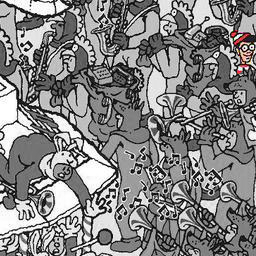

In [29]:
img

In [79]:
TEST_IMG = "/content/Mask_RCNN/data/train/3.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (1346, 2048, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 2048.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


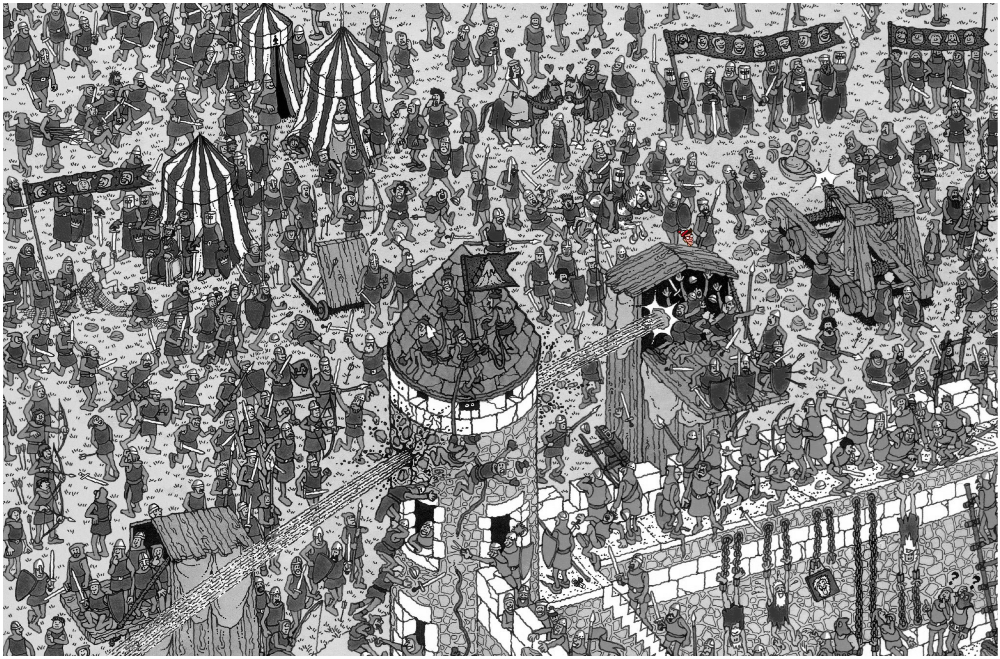

In [80]:
plt.figure(figsize=(45, 30))
plt.axis('off')
plt.imshow(img)

In [81]:
TEST_IMG = "/content/Mask_RCNN/data/train/9.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (951, 1298, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1298.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


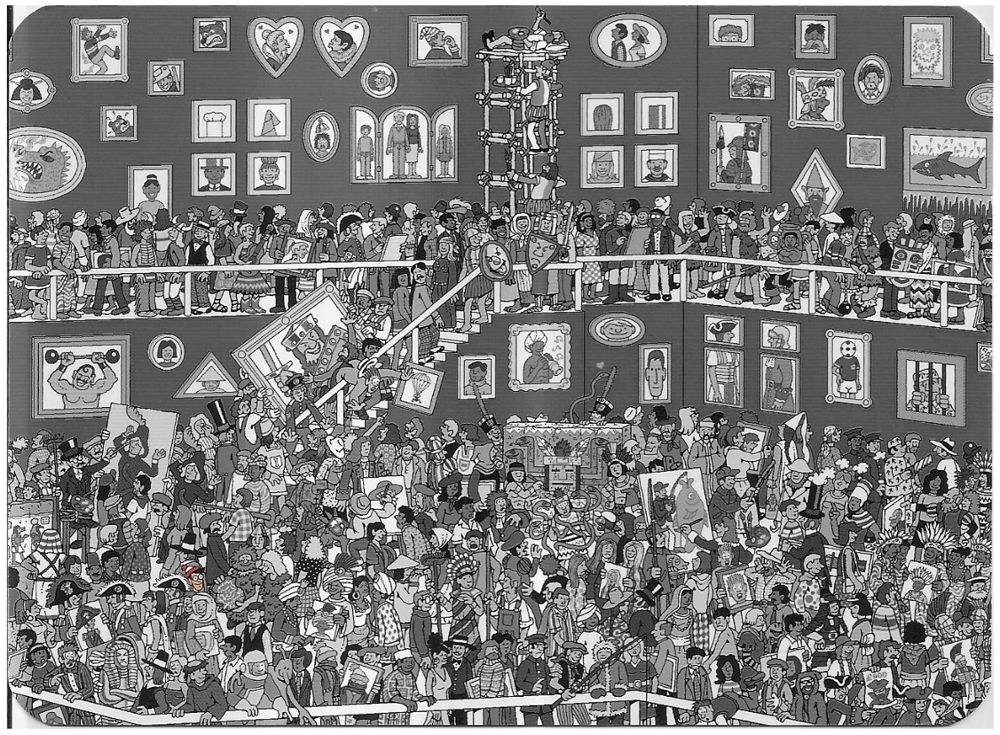

In [84]:
plt.figure(figsize=(40, 15))
plt.axis('off')
plt.imshow(img)

In [85]:
TEST_IMG = "/content/7.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (1080, 1920, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1920.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


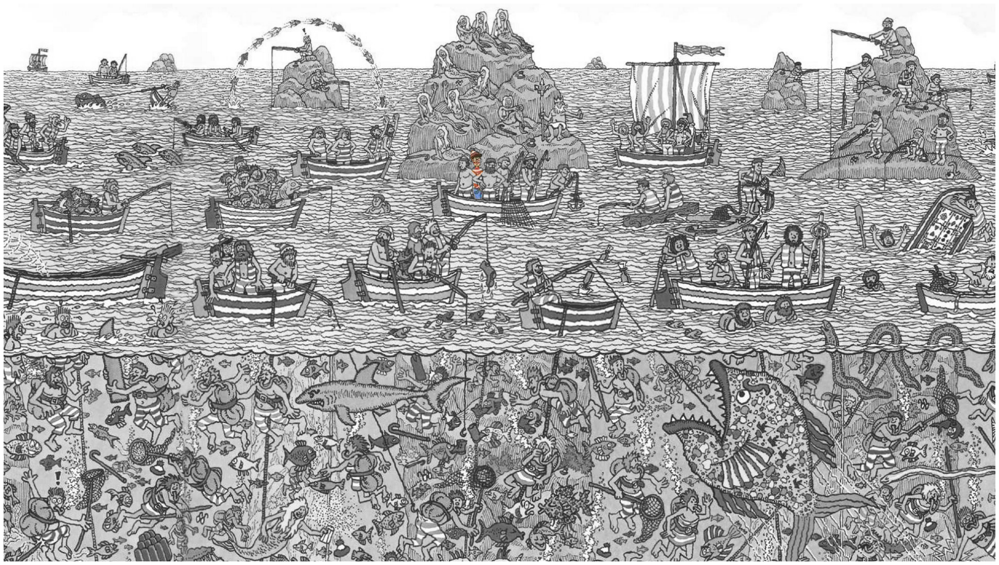

In [87]:
plt.figure(figsize=(45, 20))
plt.axis('off')
plt.imshow(img)

# EPOCH 38

sample image

In [38]:
model.load_weights("/content/Mask_RCNN/data/logs/wally20200425T0156/mask_rcnn_wally_0038.h5", by_name=True)

Re-starting from epoch 38


In [39]:
TEST_IMG = "/content/7.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (1080, 1920, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1920.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


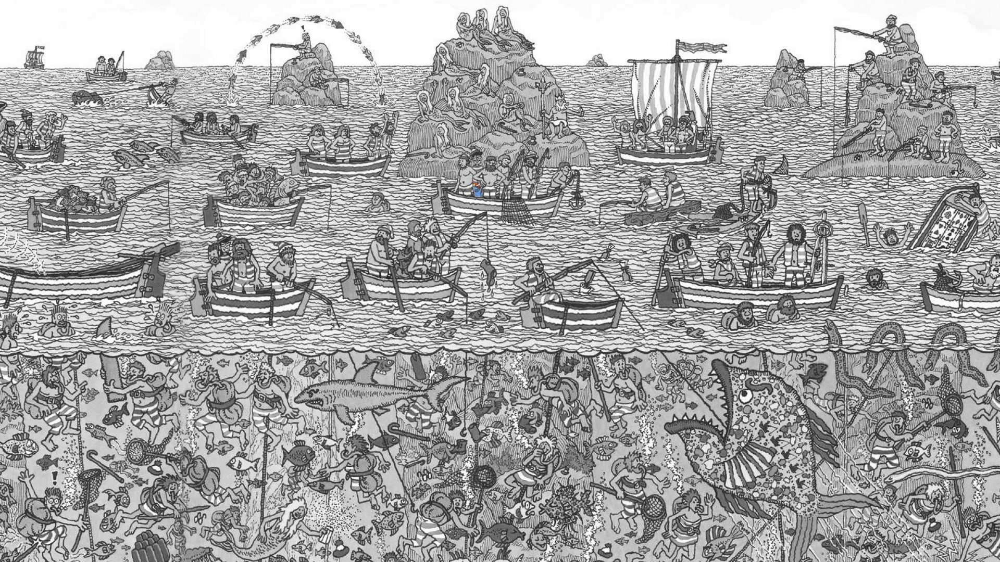

In [40]:
img

# EPOCH 36

sample image

In [41]:
model.load_weights("/content/Mask_RCNN/data/logs/wally20200425T0156/mask_rcnn_wally_0036.h5", by_name=True)

Re-starting from epoch 36


In [42]:
TEST_IMG = "/content/7.jpg"
image = skimage.io.imread(TEST_IMG) # Loading the image to display
masks = model.detect([image], verbose=1)[0]["masks"]
gray = skimage.color.gray2rgb(skimage.color.rgb2gray(image)) * 255
mask2 = (np.sum(masks, -1, keepdims=True) >= 1)
splash = np.where(mask2, image, gray).astype(np.uint8)
img = Image.fromarray(splash, 'RGB')

Processing 1 images
image                    shape: (1080, 1920, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1920.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


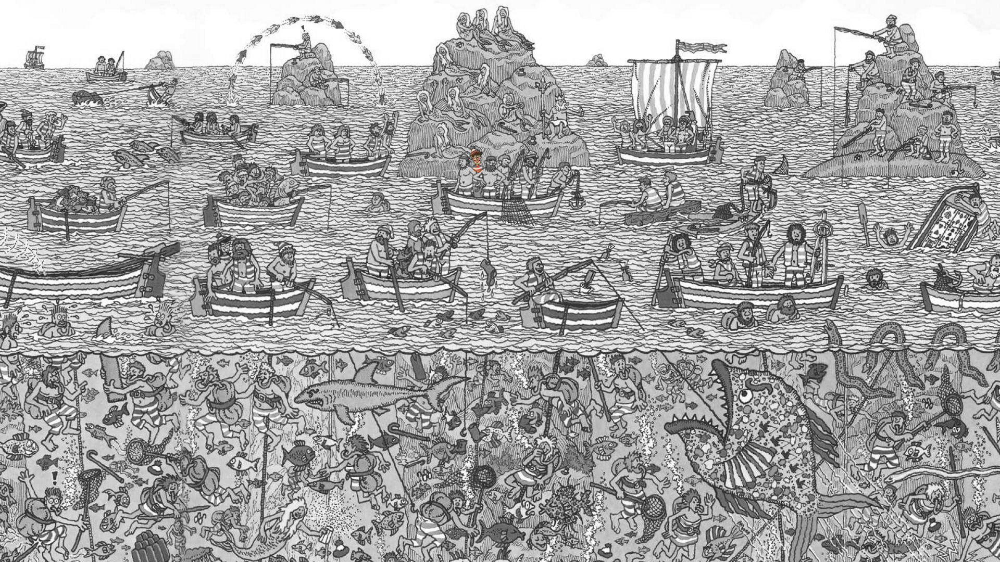

In [43]:
img